<a href="https://colab.research.google.com/github/khai1531/Crime/blob/main/DACrime.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Data loading





In [ ]:
import pandas as pd

file_path = '/content/drive/MyDrive/Crime/Crime_Data_from_2020_to_Present.csv'
try:
    df = pd.read_csv(file_path)
    print("File loaded successfully.")
    print(df.head())
except FileNotFoundError:
    print("Error: File 'Crime_Data_from_2020_to_Present.csv' not found.")
except pd.errors.ParserError:
    print("Error: Unable to parse the CSV file. Please check the file format.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

File loaded successfully.
       DR_NO               Date Rptd                DATE OCC  TIME OCC  AREA  \
0  190326475  03/01/2020 12:00:00 AM  03/01/2020 12:00:00 AM      2130     7   
1  200106753  02/09/2020 12:00:00 AM  02/08/2020 12:00:00 AM      1800     1   
2  200320258  11/11/2020 12:00:00 AM  11/04/2020 12:00:00 AM      1700     3   
3  200907217  05/10/2023 12:00:00 AM  03/10/2020 12:00:00 AM      2037     9   
4  200412582  09/09/2020 12:00:00 AM  09/09/2020 12:00:00 AM       630     4   

    AREA NAME  Rpt Dist No  Part 1-2  Crm Cd  \
0    Wilshire          784         1     510   
1     Central          182         1     330   
2   Southwest          356         1     480   
3    Van Nuys          964         1     343   
4  Hollenbeck          413         1     510   

                                Crm Cd Desc  ... Status   Status Desc  \
0                          VEHICLE - STOLEN  ...     AA  Adult Arrest   
1                     BURGLARY FROM VEHICLE  ...     IC   

## Data exploration

### Subtask:
Explore the loaded crime data to understand its characteristics.


**Reasoning**:
Examine the shape, data types, descriptive statistics, missing values, categorical distributions, unique values in text columns, and correlations between numerical features of the DataFrame to understand its characteristics. Visualize the distribution of missing values using a bar chart.



Shape of the DataFrame: (1005199, 28)

Data Types:
 DR_NO               int64
Date Rptd          object
DATE OCC           object
TIME OCC            int64
AREA                int64
AREA NAME          object
Rpt Dist No         int64
Part 1-2            int64
Crm Cd              int64
Crm Cd Desc        object
Mocodes            object
Vict Age            int64
Vict Sex           object
Vict Descent       object
Premis Cd         float64
Premis Desc        object
Weapon Used Cd    float64
Weapon Desc        object
Status             object
Status Desc        object
Crm Cd 1          float64
Crm Cd 2          float64
Crm Cd 3          float64
Crm Cd 4          float64
LOCATION           object
Cross Street       object
LAT               float64
LON               float64
dtype: object

Descriptive Statistics:
               DR_NO      TIME OCC          AREA   Rpt Dist No      Part 1-2  \
count  1.005199e+06  1.005199e+06  1.005199e+06  1.005199e+06  1.005199e+06   
mean   2.202278e+08  1

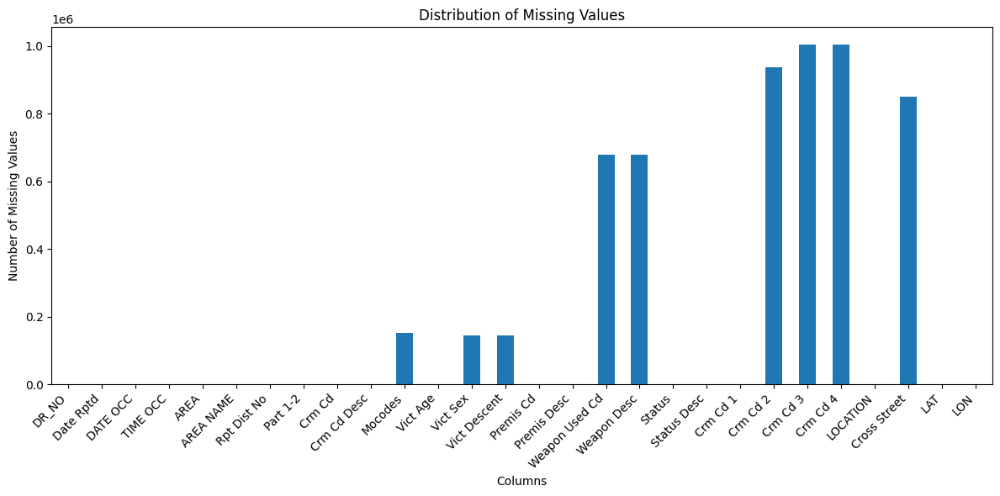


Value Counts for Date Rptd:
Date Rptd
02/02/2023 12:00:00 AM    929
02/03/2023 12:00:00 AM    927
01/03/2023 12:00:00 AM    914
05/02/2022 12:00:00 AM    909
04/04/2022 12:00:00 AM    883
                         ... 
03/15/2025 12:00:00 AM      1
03/02/2025 12:00:00 AM      1
01/18/2025 12:00:00 AM      1
01/25/2025 12:00:00 AM      1
03/31/2025 12:00:00 AM      1
Name: count, Length: 1909, dtype: int64

Value Counts for DATE OCC:
DATE OCC
01/01/2020 12:00:00 AM    1164
01/01/2023 12:00:00 AM    1160
12/02/2022 12:00:00 AM    1132
02/01/2023 12:00:00 AM    1093
10/01/2022 12:00:00 AM    1079
                          ... 
03/30/2025 12:00:00 AM       1
01/19/2025 12:00:00 AM       1
01/03/2025 12:00:00 AM       1
03/02/2025 12:00:00 AM       1
01/04/2025 12:00:00 AM       1
Name: count, Length: 1904, dtype: int64

Value Counts for AREA NAME:
AREA NAME
Central        69673
77th Street    61762
Pacific        59521
Southwest      57512
Hollywood      52430
N Hollywood    51107
Olympic 

In [ ]:
import matplotlib.pyplot as plt

# 1. Shape of the DataFrame
print("Shape of the DataFrame:", df.shape)

# 2. Data types of each column
print("\nData Types:\n", df.dtypes)

# 3. Descriptive statistics for numerical columns
print("\nDescriptive Statistics:\n", df.describe())

# 4. Missing values
missing_values = df.isnull().sum()
print("\nMissing Values:\n", missing_values)

plt.figure(figsize=(12, 6))
missing_values.plot(kind='bar')
plt.title('Distribution of Missing Values')
plt.xlabel('Columns')
plt.ylabel('Number of Missing Values')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# 5. Distribution of categorical columns
categorical_cols = df.select_dtypes(include=['object']).columns
for col in categorical_cols:
    print(f"\nValue Counts for {col}:\n{df[col].value_counts()}")

# 6. Unique values in text columns
text_cols = ['Crm Cd Desc', 'LOCATION', 'Premis Desc', 'Weapon Desc', 'Status Desc']
for col in text_cols:
    print(f"\nUnique values in {col}:\n{df[col].unique()[:20]}") # display first 20 unique values

# 7. Correlation between numerical features
numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()
print("\nCorrelation Matrix:\n", correlation_matrix)

## Data cleaning

### Subtask:
Clean the crime data by handling missing values and outliers.


**Reasoning**:
Handle missing values in specified columns by replacing them with "Unknown" and impute missing values in other columns using median for numerical features and mode for categorical features. Remove rows with missing values in crucial columns ('Vict Age', 'Vict Sex', 'Vict Descent').



In [ ]:
import pandas as pd
import numpy as np

# Replace missing values in specific columns with "Unknown"
columns_to_fill_unknown = ['Weapon Used Cd', 'Weapon Desc', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4']
df[columns_to_fill_unknown] = df[columns_to_fill_unknown].fillna("Unknown")

# Impute missing values for numerical features with the median
numerical_cols = df.select_dtypes(include=np.number).columns
for col in numerical_cols:
    if col != 'DR_NO': # Skip DR_NO as it is an ID
        df[col] = df[col].fillna(df[col].median())

# Impute missing values for categorical features with the mode
categorical_cols = df.select_dtypes(include='object').columns
for col in categorical_cols:
    if col not in columns_to_fill_unknown:
        df[col] = df[col].fillna(df[col].mode()[0])

# Remove rows with missing values in crucial columns
crucial_cols = ['Vict Age', 'Vict Sex', 'Vict Descent']
df.dropna(subset=crucial_cols, inplace=True)

# Check for missing values after imputation
print(df.isnull().sum())
display(df.head())

DR_NO             0
Date Rptd         0
DATE OCC          0
TIME OCC          0
AREA              0
AREA NAME         0
Rpt Dist No       0
Part 1-2          0
Crm Cd            0
Crm Cd Desc       0
Mocodes           0
Vict Age          0
Vict Sex          0
Vict Descent      0
Premis Cd         0
Premis Desc       0
Weapon Used Cd    0
Weapon Desc       0
Status            0
Status Desc       0
Crm Cd 1          0
Crm Cd 2          0
Crm Cd 3          0
Crm Cd 4          0
LOCATION          0
Cross Street      0
LAT               0
LON               0
dtype: int64


,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,190326475,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,AA,Adult Arrest,510.0,998.0,Unknown,Unknown,1900 S LONGWOOD AV,BROADWAY,34.0375,-118.3506
1,200106753,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,IC,Invest Cont,330.0,998.0,Unknown,Unknown,1000 S FLOWER ST,BROADWAY,34.0444,-118.2628
2,200320258,11/11/2020 12:00:00 AM,11/04/2020 12:00:00 AM,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,IC,Invest Cont,480.0,Unknown,Unknown,Unknown,1400 W 37TH ST,BROADWAY,34.0210,-118.3002
3,200907217,05/10/2023 12:00:00 AM,03/10/2020 12:00:00 AM,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,IC,Invest Cont,343.0,Unknown,Unknown,Unknown,14000 RIVERSIDE DR,BROADWAY,34.1576,-118.4387
4,200412582,09/09/2020 12:00:00 AM,09/09/2020 12:00:00 AM,630,4,Hollenbeck,413,1,510,VEHICLE - STOLEN,...,IC,Invest Cont,510.0,Unknown,Unknown,Unknown,200 E AVENUE 28,BROADWAY,34.0820,-118.2130


**Reasoning**:
Handle outliers in 'Vict Age' by replacing negative ages with the median age, and examine and handle zero values in 'LAT' and 'LON' by replacing them with the median of the respective columns, grouped by 'AREA NAME'.



In [ ]:
# Handle outliers in 'Vict Age'
df.loc[df['Vict Age'] < 0, 'Vict Age'] = df['Vict Age'].median()

# Handle zero values in 'LAT' and 'LON'
for col in ['LAT', 'LON']:
    # Group by 'AREA NAME' and replace 0 with the median of the group
    df[col] = df.groupby('AREA NAME')[col].transform(lambda x: x.replace(0, x[x != 0].median()) if x[x != 0].median() else x.median())

display(df.describe())

,DR_NO,TIME OCC,AREA,Rpt Dist No,Part 1-2,Crm Cd,Vict Age,Premis Cd,Crm Cd 1,LAT,LON
count,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06,1.005199e+06
mean,2.202278e+08,1.339912e+03,1.069097e+01,1.115556e+03,1.400284e+00,5.001459e+02,2.891678e+01,3.056175e+02,4.999058e+02,3.407413e+01,-1.183546e+02
std,1.320295e+07,6.510515e+02,6.110387e+00,6.111736e+02,4.899561e-01,2.052633e+02,2.199097e+01,2.193147e+02,2.050628e+02,1.111605e-01,1.044097e-01
min,8.170000e+02,1.000000e+00,1.000000e+00,1.010000e+02,1.000000e+00,1.100000e+02,0.000000e+00,1.010000e+02,1.100000e+02,3.370590e+01,-1.186676e+02
25%,2.106169e+08,9.000000e+02,5.000000e+00,5.870000e+02,1.000000e+00,3.310000e+02,0.000000e+00,1.010000e+02,3.310000e+02,3.401530e+01,-1.184308e+02
50%,2.209160e+08,1.420000e+03,1.100000e+01,1.139000e+03,1.000000e+00,4.420000e+02,3.000000e+01,2.030000e+02,4.420000e+02,3.405920e+01,-1.183230e+02
75%,2.311105e+08,1.900000e+03,1.600000e+01,1.613000e+03,2.000000e+00,6.260000e+02,4.400000e+01,5.010000e+02,6.260000e+02,3.416490e+01,-1.182740e+02
max,2.521041e+08,2.359000e+03,2.100000e+01,2.199000e+03,2.000000e+00,9.560000e+02,1.200000e+02,9.760000e+02,9.560000e+02,3.433430e+01,-1.181554e+02


**Reasoning**:
Convert 'Date Rptd' and 'DATE OCC' columns to datetime objects, then validate date and time consistency.



In [ ]:
import pandas as pd

# Convert date columns to datetime objects
df['Date Rptd'] = pd.to_datetime(df['Date Rptd'])
df['DATE OCC'] = pd.to_datetime(df['DATE OCC'])

# Check for chronological order and consistency (Date Rptd >= DATE OCC)
df['Date_Diff'] = (df['Date Rptd'] - df['DATE OCC']).dt.days
invalid_dates = df[df['Date_Diff'] < 0]

# Print invalid date information
print(f"Number of invalid dates where 'Date Rptd' is before 'DATE OCC': {len(invalid_dates)}")

# Display the first 10 rows with invalid dates
display(invalid_dates.head(10))



<ipython-input-25-ac5c857509ee>:4: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Date Rptd'] = pd.to_datetime(df['Date Rptd'])
<ipython-input-25-ac5c857509ee>:5: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['DATE OCC'] = pd.to_datetime(df['DATE OCC'])


Number of invalid dates where 'Date Rptd' is before 'DATE OCC': 0


,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Date_Diff


## Data wrangling

### Subtask:
Prepare the data for analysis and visualization.


**Reasoning**:
Create new features, convert data types, and aggregate data as instructed in the subtask.



In [ ]:
import pandas as pd

# Feature Engineering
df['Rpt_Year'] = df['Date Rptd'].dt.year
df['Rpt_Month'] = df['Date Rptd'].dt.month
df['Rpt_Day'] = df['Date Rptd'].dt.day
df['Occ_Year'] = df['DATE OCC'].dt.year
df['Occ_Month'] = df['DATE OCC'].dt.month
df['Occ_Day'] = df['DATE OCC'].dt.day

# Time of Day
def categorize_time(time_str):
    time_int = int(time_str)
    if 600 <= time_int < 1200:
        return "Morning"
    elif 1200 <= time_int < 1800:
        return "Afternoon"
    elif 1800 <= time_int < 2400:
        return "Evening"
    else:
        return "Night"
df['Time_of_Day'] = df['TIME OCC'].astype(str).apply(categorize_time)


# Combined Location (Example:  You can customize this based on your needs)
df['Combined_Location'] = df['AREA NAME'] + ', ' + df['LOCATION'] + ' ' + df['Cross Street']

# Data Type Conversion (Example: Convert Vict Age to integer - handle potential errors)
df['Vict Age'] = pd.to_numeric(df['Vict Age'], errors='coerce').astype('Int64')

# Data Aggregation
monthly_crime_counts = df.groupby(['Rpt_Month', 'AREA NAME'])['DR_NO'].count().reset_index(name='Crime_Count')
crime_type_counts = df.groupby('Crm Cd Desc')['DR_NO'].count().reset_index(name='Crime_Count')
time_location_crime = df.groupby(['Time_of_Day', 'AREA NAME'])['DR_NO'].count().reset_index(name='Crime_Count')

# Store in df_processed
df_processed = df.copy()
display(df_processed.head())

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,LON,Date_Diff,Rpt_Year,Rpt_Month,Rpt_Day,Occ_Year,Occ_Month,Occ_Day,Time_of_Day,Combined_Location
0,190326475,2020-03-01,2020-03-01,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,-118.3506,0,2020,3,1,2020,3,1,Evening,"Wilshire, 1900 S LONGWOOD ..."
1,200106753,2020-02-09,2020-02-08,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,-118.2628,1,2020,2,9,2020,2,8,Evening,"Central, 1000 S FLOWER ..."
2,200320258,2020-11-11,2020-11-04,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,-118.3002,7,2020,11,11,2020,11,4,Afternoon,"Southwest, 1400 W 37TH ..."
3,200907217,2023-05-10,2020-03-10,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,-118.4387,1156,2023,5,10,2020,3,10,Evening,"Van Nuys, 14000 RIVERSIDE ..."
4,200412582,2020-09-09,2020-09-09,630,4,Hollenbeck,413,1,510,VEHICLE - STOLEN,...,-118.2130,0,2020,9,9,2020,9,9,Morning,"Hollenbeck, 200 E AVENUE 28 BROADWAY"


## Data visualization

### Subtask:
Visualize the prepared crime data to gain insights.


**Reasoning**:
Visualize the prepared crime data using various plot types as instructed.



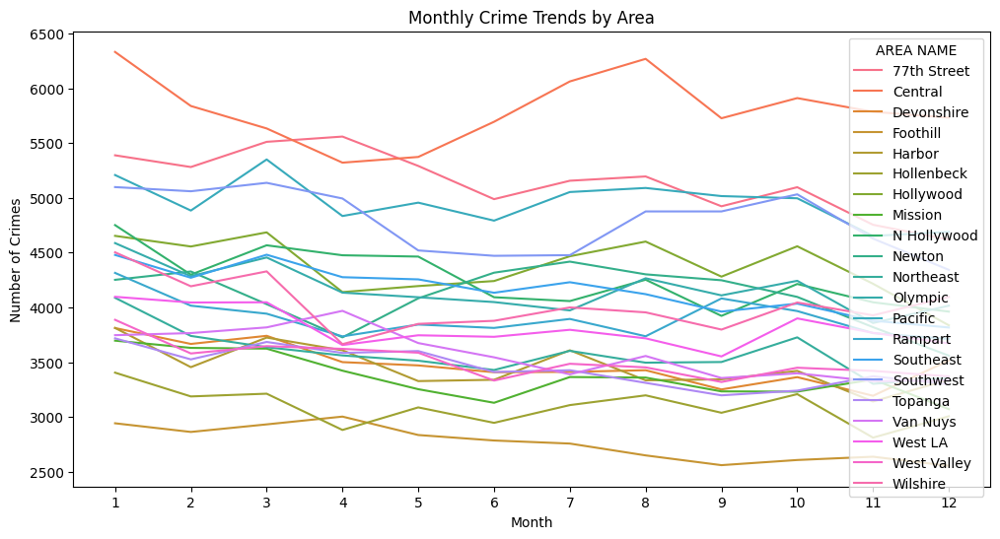

<Figure size 1000x600 with 0 Axes>

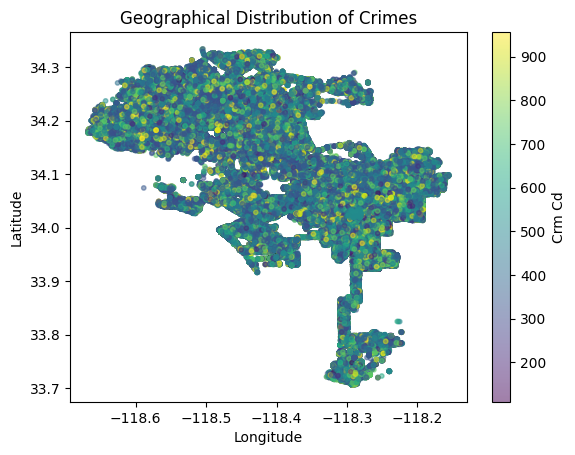

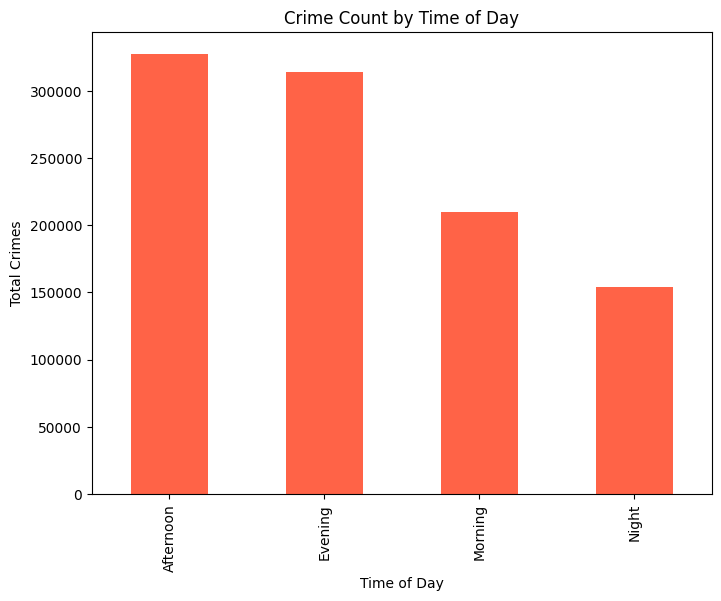

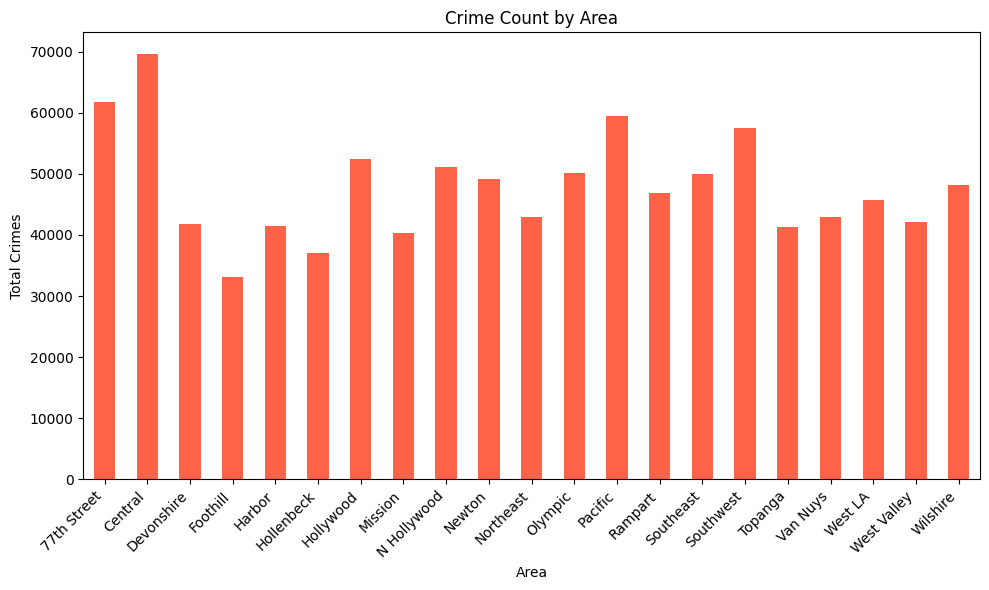

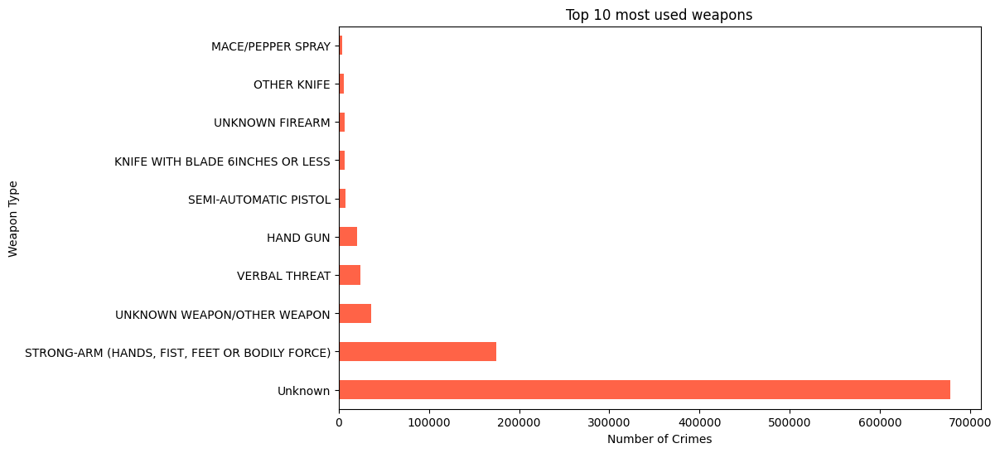

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import os

plt.figure(figsize=(12, 6))
sns.lineplot(x='Rpt_Month', y='Crime_Count', hue='AREA NAME', data=monthly_crime_counts)
plt.title('Monthly Crime Trends by Area')
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.xticks(range(1, 13))
plt.show()


plt.figure(figsize=(10, 6))
df.plot.scatter(x='LON', y='LAT', c='Crm Cd', cmap='viridis', alpha=0.5, s=10)
plt.title('Geographical Distribution of Crimes')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


plt.figure(figsize=(100, 60))
crime_type_counts.set_index('Crm Cd Desc')['Crime_Count'].plot(kind='bar', color='tomato')
plt.title('Distribution of Crime Types')
plt.xlabel('Crime Type')
plt.ylabel('Number of Crimes')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6))
time_location_crime.groupby('Time_of_Day')['Crime_Count'].sum().plot(kind='bar', color='tomato')
plt.title('Crime Count by Time of Day')
plt.xlabel('Time of Day')
plt.ylabel('Total Crimes')
plt.show()

plt.figure(figsize=(10, 6))
time_location_crime.groupby('AREA NAME')['Crime_Count'].sum().plot(kind='bar', color='tomato')
plt.title('Crime Count by Area')
plt.xlabel('Area')
plt.ylabel('Total Crimes')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

output_dir = 'plots'  # or any other path you prefer

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

weapon_counts = df['Weapon Desc'].value_counts().nlargest(10)
weapon_counts.plot(kind='barh', figsize=(10, 6), color='tomato')
plt.title("Top 10 most used weapons")
plt.xlabel("Number of Crimes")
plt.ylabel("Weapon Type")
plt.savefig(f"{output_dir}/top10_weapons.png") # Now output_dir is defined
plt.show()



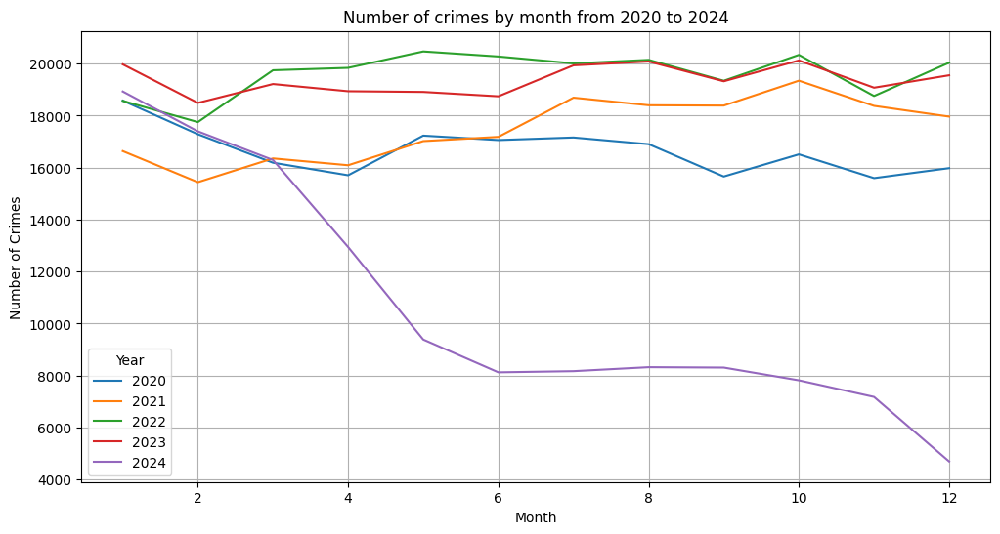

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

df['DATE OCC'] = pd.to_datetime(df['DATE OCC'])
df['Month'] = df['DATE OCC'].dt.month
df['Year'] = df['DATE OCC'].dt.year

# Filter out data beyond 2024
df_filtered = df[df['Year'] <= 2024]

monthly_crime = df_filtered.groupby(['Year', 'Month']).size().unstack(level=0)
monthly_crime.plot(figsize=(12, 6))
plt.title("Number of crimes by month from 2020 to 2024")
plt.xlabel("Month")
plt.ylabel("Number of Crimes")
plt.grid(True)
plt.show()


In [ ]:
import folium
from folium.plugins import HeatMap

# Tạo bản đồ tập trung vào trung tâm của dữ liệu
map_center = [df_processed['LAT'].mean(), df_processed['LON'].mean()]
crime_map = folium.Map(location=map_center, zoom_start=12)

# Thêm HeatMap để thể hiện mật độ dân số
# Giả sử df_processed có chứa cột 'Population'
heat_data = [[row['LAT'], row['LON'], row['Vict Age']] for index, row in df_processed.iterrows()] # Thay 'Vict Age' bằng cột mật độ dân số của bạn
HeatMap(heat_data).add_to(crime_map)

# Hiển thị bản đồ
crime_map

crime_map.save('crime_map.html')